In [ ]:
import pandas as pd
import plotly.graph_objects as go

In [ ]:
# -----------------------------------------------------------
# LOAD DATA
# -----------------------------------------------------------
df = pd.read_csv(r"C:\Users\torne\Downloads\EQR_output_EDA.csv")

# Convert dates in one operation
df[["trade_date_year_mo", "delivery_year_mo"]] = df[
    ["trade_date_year_mo", "delivery_year_mo"]
].apply(pd.to_datetime)

# Delivery label
df["delivery_label"] = df["delivery_year_mo"].dt.strftime("%Y-%m")
 
months = sorted(df["delivery_label"].unique())

In [ ]:
# -----------------------------------------------------------
# PREP DATA (with FIXED VOLUME SHADING)
# -----------------------------------------------------------
def prep(month):
    d = df[df["delivery_label"] == month].sort_values("trade_date_year_mo")

    # Fill missing dates
    full_dates = pd.date_range(
        d["trade_date_year_mo"].min(),
        d["trade_date_year_mo"].max(),
        freq="D"
    )

    d2 = (
        d.set_index("trade_date_year_mo")
         .reindex(full_dates)
         .rename_axis("trade_date")
         .copy()
    )

    # Interpolate missing values
    d2["weighted_avg_price"] = d2["weighted_avg_price"].interpolate()
    d2["total_transacted_quantity"] = d2["total_transacted_quantity"].fillna(0)

    # -------------------------------------------------------
    # FIXED, VISIBLE, HIGH-QUALITY VOLUME INTENSITY SHADING
    # -------------------------------------------------------
    q = d2["total_transacted_quantity"]

    # Normalize safely
    if q.max() > 0:
        q_scaled = q / q.max()
    else:
        q_scaled = q * 0

    price_min = d2["weighted_avg_price"].min()
    price_max = d2["weighted_avg_price"].max()
    price_range = price_max - price_min

    #Increase shading height for visibility (25% of price range)
    shade_height = price_range * 0.25  

    d2["volume_shade"] = price_min + q_scaled * shade_height

    return d2


processed = {m: prep(m) for m in months}

# Default month
current = months[0]
data = processed[current]

In [ ]:
# -----------------------------------------------------------
# BUILD INTERACTIVE LINE GRAPH
# -----------------------------------------------------------
fig = go.Figure()

# VISIBLE Volume shading ("strong" color)
fig.add_trace(go.Scatter(
    x=data.index,
    y=data["volume_shade"],
    fill="tozeroy",
    fillcolor="rgba(52, 152, 219, 0.30)",  # darker blue for visibility
    line=dict(color="rgba(0,0,0,0)"),
    name="Volume Intensity",
    hoverinfo="skip"
))

# Main price line
fig.add_trace(go.Scatter(
    x=data.index,
    y=data["weighted_avg_price"],
    mode="lines",
    line=dict(color="#1F4FFF", width=3),
    name="Price",
    hovertemplate="<b>Date:</b> %{x}<br><b>Price:</b> %{y:.2f}<extra></extra>"
))

In [ ]:
# -----------------------------------------------------------
# DROPDOWN FOR MONTH SELECTION
# -----------------------------------------------------------
buttons = []
for m in months:
    d = processed[m]
    buttons.append(dict(
        label=m,
        method="update",
        args=[
            {
                "x": [d.index, d.index],
                "y": [d["volume_shade"], d["weighted_avg_price"]],
            },
            {"title": f"Interactive Price Graph — {m}"}
        ]
    ))

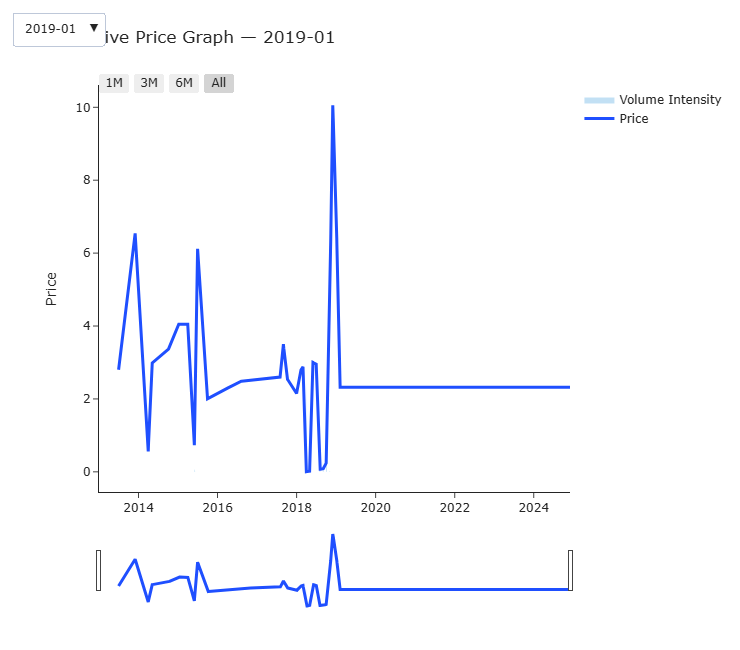

In [10]:
# -----------------------------------------------------------
# LAYOUT
# -----------------------------------------------------------
fig.update_layout(
    title=f"Interactive Price Graph — {current}",
    template="simple_white",
    height=650,

    updatemenus=[dict(
        buttons=buttons,
        direction="down",
        showactive=True,
        x=0.01,
        y=1.18
    )],

    xaxis=dict(
        rangeslider=dict(visible=True),
        rangeselector=dict(
            buttons=[
                dict(count=30, label="1M", step="day", stepmode="backward"),
                dict(count=90, label="3M", step="day", stepmode="backward"),
                dict(count=180, label="6M", step="day", stepmode="backward"),
                dict(step="all", label="All"),
            ]
        )
    ),

    yaxis=dict(
        title="Price",
        gridcolor="rgba(200,200,200,0.3)"
    ),

    hovermode="x unified",
    margin=dict(l=50, r=30, t=80, b=40)
)

fig.show()